In [1]:
# Workaround to use src modules
import os
import sys
module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)

In [2]:
# Library imports
import imageio
import numpy as np
import matplotlib.pyplot as plt

from skimage import filters
from skimage.color import rgb2lab
from scipy.stats import mode

from sklearn.cluster import KMeans
from scipy.ndimage import convolve
from scipy.ndimage import gaussian_filter

# Functions Imports
from src.utils import image_to_grayscale, image_minmax_norm, load_image, image_downsampling
from src.quantization import image_bitshift, palette_kmeans
from src.segmentation import threshold_segmentation, otsu_segmentation, labels_to_edges, labels_to_edges_thin
from src.visualizations import visualize_bitshift_images, plot_pallete, plot_imagegrid

## Objetivo

Adicionar as etapas de pré-processamento (down-sampling & gaussian), passar para extração de paleta e em seguida salvar os resultados no path desejado :)

Para cada imagem, exibimos a paleta de cores extraidas com o método Kmeans e a seguinte progressão da imagem original (após o uso do gaussiano), a imagem de preview (recolorida com as cores da paleta) e imagem de bordas gerada.

O resultado final deste pipeline gera uma imagem colorível satisfatoria em muitos casos (principalmente se a imagem de entrada já for uma imagem artificial bem definida como o caso da anime_girl) mas em muitas situações pode gerar regiões pequenas ou estreitas demais para serem coloridas (o que foi resolvido em um momento futuro)

In [3]:
def exploratory_pipeline(image_path, N=8, palette_shape=(2,8), save_name=None, plot=True):
    outpath = "../images/exploratory"
    
    # 1º Step - Loading RGB image (ignore 4º channel if exists with image[:,:,:3])
    print("1º Step - Loading image....")
    image = load_image(image_path)[:,:,:3]
    
    # 2º Step - Pré-processing
    # ------------------------
    # - Imagen Downsampling (max size to 1024)
    # - Gaussian Filter (sigma=2 to smooth without lose much details)
    print("2º Step - Image pre-processing")
    image = image_downsampling(image)
    image_smooth = np.zeros(image.shape)
    for c in range(3):
        image_smooth[:,:,c] = gaussian_filter(image[:,:,c], sigma=2, mode='nearest')
    
    # 3º Step - Palette Extraction (Kmeans) & Edge Detection
    # ------------------------------------------------------
    print("3º Step - Palette extraction")
    palette, image_recolorized, labelsmap, _ = palette_kmeans(image_smooth, N)
    # edgemap = labels_to_edges(labelsmap)
    edgemap = labels_to_edges_thin(labelsmap)
    
    
    # 4º Step - Region & Edgemap Processing (On going)
    # ------------------------------------------------
    # - Remove too small color regions (using synflood to calculate region areas)
    # - Remove thick edges (increase % of drawable area)
    
    # Last Step - Saving results to visualization
    if save_name != None:
        print("Exporting images...")
        imageio.imwrite(f"{outpath}/{save_name}_00_sampled.jpg", image)
        imageio.imwrite(f"{outpath}/{save_name}_01_smooth.jpg", image_smooth)
        imageio.imwrite(f"{outpath}/{save_name}_02_recolorized.jpg", image_recolorized)
        #imageio.imwrite(f"{outpath}/{save_name}_03_edges.jpg", edgemap * 255)
        imageio.imwrite(f"{outpath}/{save_name}_03_edges_thin.jpg", edgemap * 255)
    
    # Extra Step - Plotting Pallete end results in jupyter
    print("Drawable area: ", np.sum(edgemap == 0)/edgemap.size)
    if plot:
        plot_pallete(palette, palette_shape)
        plot_imagegrid([image, image_recolorized, edgemap], shape=(1,3), figsize=(40,40))
    
#     return labelsmap

1º Step - Loading image....
2º Step - Image pre-processing
3º Step - Palette extraction


Lossy conversion from int32 to uint8. Range [0, 255]. Convert image to uint8 prior to saving to suppress this warning.


Exporting images...
Drawable area:  0.823901921311749


array([[ 3,  3,  3, ..., 15, 15, 15],
       [ 3,  3,  3, ..., 15, 15, 15],
       [ 3,  3,  3, ..., 15, 15, 15],
       ...,
       [ 3,  3,  3, ...,  7,  7,  7],
       [ 3,  3,  3, ...,  7,  7,  7],
       [ 3,  3,  3, ...,  7,  7,  7]], dtype=int32)

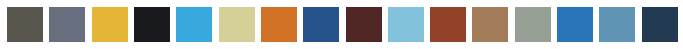

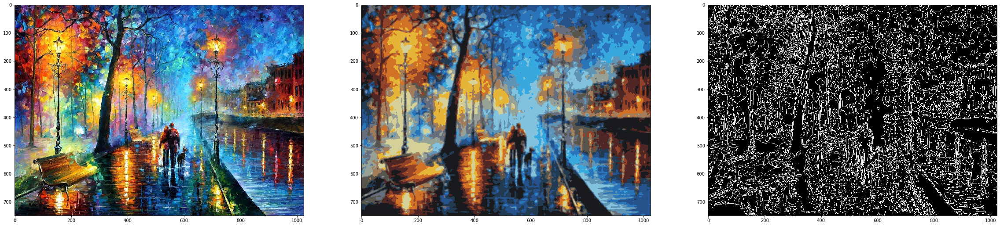

In [4]:
exploratory_pipeline('../images/raw/painting_afremov.jpg', N=16, palette_shape=(1,16), save_name="afremov")

1º Step - Loading image....
2º Step - Image pre-processing
3º Step - Palette extraction


Lossy conversion from int32 to uint8. Range [0, 255]. Convert image to uint8 prior to saving to suppress this warning.


Exporting images...
Drawable area:  0.8313363607247438


array([[14, 14, 14, ..., 13, 13, 13],
       [14, 14, 14, ..., 13, 13, 13],
       [14, 14, 14, ..., 13, 13, 13],
       ...,
       [ 4,  4,  4, ...,  6, 13, 13],
       [ 4,  4,  4, ..., 13, 13, 13],
       [ 4,  4,  4, ..., 13, 13, 13]], dtype=int32)

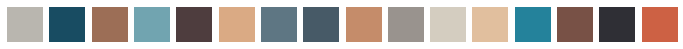

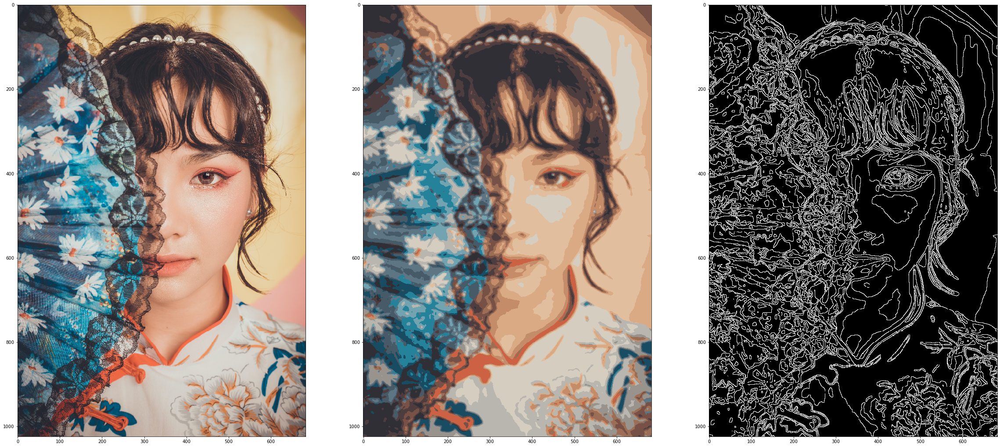

In [5]:
exploratory_pipeline('../images/raw/oriental_selfie.jpg', N=16, palette_shape=(1,16), save_name="oriental_selfie")

In [6]:
# exploratory_pipeline('../images/raw/abstract_ocean.png', N=16, palette_shape=(1,16), save_name="abstract_ocean")

1º Step - Loading image....
2º Step - Image pre-processing
3º Step - Palette extraction


Lossy conversion from int32 to uint8. Range [0, 255]. Convert image to uint8 prior to saving to suppress this warning.


Exporting images...
Drawable area:  0.8556060862382947


array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       ...,
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1]], dtype=int32)

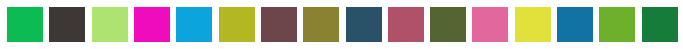

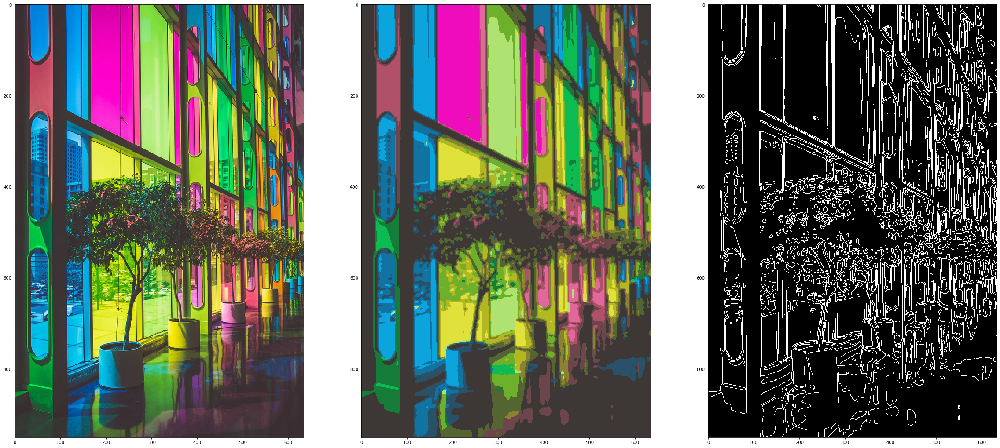

In [7]:
exploratory_pipeline('../images/raw/scenario_rainbow.png', N=16, palette_shape=(1,16), save_name="scenario_rainbow")

In [8]:
# exploratory_pipeline('../images/raw/polaroid.png', N=16, palette_shape=(1,16), save_name="polaroid")

1º Step - Loading image....
2º Step - Image pre-processing
3º Step - Palette extraction


Lossy conversion from int32 to uint8. Range [0, 255]. Convert image to uint8 prior to saving to suppress this warning.


Exporting images...
Drawable area:  0.7861783333333333


array([[ 9,  9,  9, ...,  9,  9, 14],
       [ 3,  9,  9, ...,  9,  9, 14],
       [ 3,  9,  9, ...,  9,  9, 14],
       ...,
       [ 3,  3,  9, ...,  6,  6,  6],
       [ 3,  3,  9, ...,  6,  6,  6],
       [ 3,  3,  9, ...,  6,  6,  6]], dtype=int32)

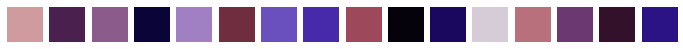

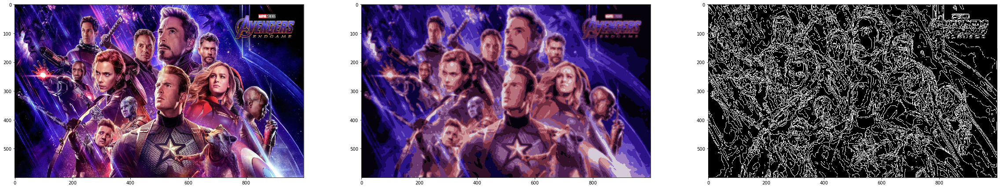

In [9]:
exploratory_pipeline('/home/gabriel/Imagens/avengers.jpg', N=16, palette_shape=(1,16), save_name="avengers")

1º Step - Loading image....
2º Step - Image pre-processing
3º Step - Palette extraction


Lossy conversion from int32 to uint8. Range [0, 255]. Convert image to uint8 prior to saving to suppress this warning.


Exporting images...
Drawable area:  0.9227706666666666


array([[ 9,  9,  9, ...,  1,  1,  1],
       [ 9,  9,  9, ...,  1,  1,  1],
       [ 9,  9,  9, ...,  1,  1,  1],
       ...,
       [14, 14, 14, ...,  3,  3,  3],
       [14, 14, 14, ...,  3,  3,  3],
       [14, 14, 14, ...,  3,  3,  3]], dtype=int32)

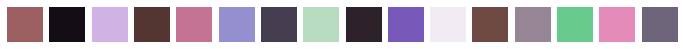

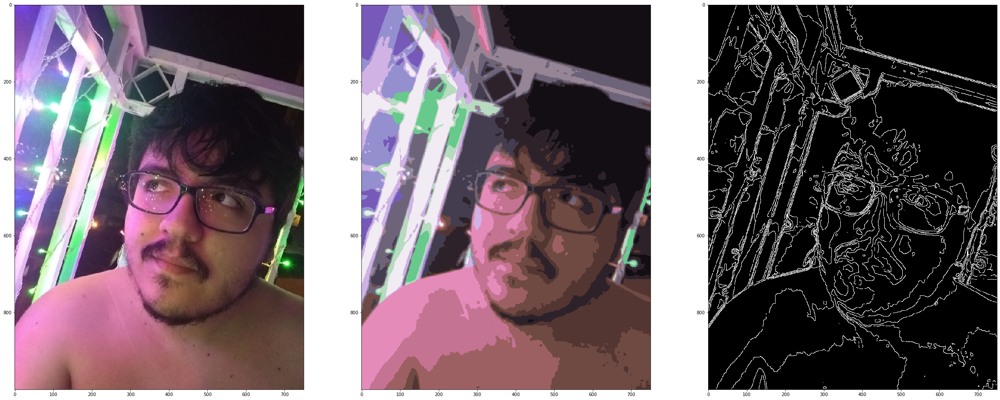

In [10]:
exploratory_pipeline('/home/gabriel/Imagens/gabriel.jpg', N=16, palette_shape=(1,16), save_name="gabriel")

1º Step - Loading image....
2º Step - Image pre-processing
3º Step - Palette extraction


Lossy conversion from float64 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0.9808697918253415, 254.35838611846538]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from int32 to uint8. Range [0, 255]. Convert image to uint8 prior to saving to suppress this warning.


Exporting images...
Drawable area:  0.8224489795918367


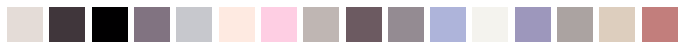

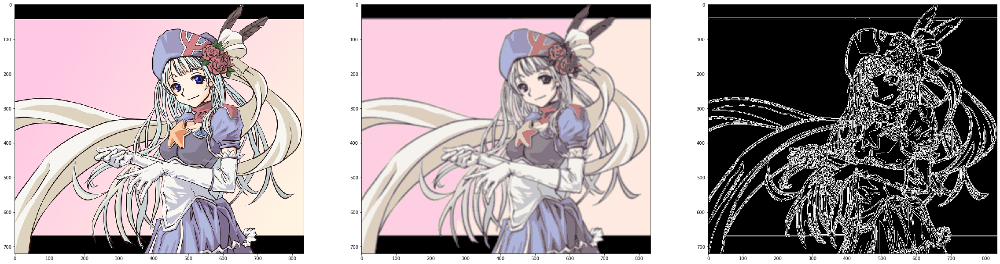

In [12]:
exploratory_pipeline('../images/raw/anime_girl.png', N=16, palette_shape=(1,16), save_name="anime_girl")

# Testing scale-space feature extraction

Nos testes abaixos tentamos utilizar de algumas referências do uso de Scale Space para extrair os segmentos em uma região de área inferior e realizando upsample do resultado obtido para a escala original.

Infelizmente as referências encontradas divergiam em alguns momentos sobre a escolha da escala e os sigmas a serem aplicados e eram utilizados em outros contextos (ex: extração de features) e devido ao tempo baixo restante esses testes foram abandonados.

In [4]:
image_path='/home/gabriel/Imagens/avengers.jpg'
N=16
palette_shape=(1,16)
save_name=None
# save_name="avengers3"

outpath = "../images/exploratory"

# 1º Step - Loading RGB image (ignore 4º channel if exists with image[:,:,:3])
print("1º Step - Loading image....")
image = load_image(image_path)[:,:,:3]

# 2º Step - Pré-processing
# ------------------------
# - Imagen Downsampling (max size to 1024)
# - Gaussian Filter (sigma=2 to smooth without lose much details)
print("2º Step - Image pre-processing")
image = image_downsampling(image)
image_smooth = np.zeros(image.shape)
for c in range(3):
    image_smooth[:,:,c] = gaussian_filter(image[:,:,c], sigma=2, mode='nearest')


# 3º Step - Palette Extraction (Kmeans) & Edge Detection
# ------------------------------------------------------
print("3º Step - Palette extraction")
palette, image_recolorized, labelsmap, model = palette_kmeans(image_smooth, N)
# edgemap = labels_to_edges(labelsmap)
edgemap = labels_to_edges_thin(labelsmap)    

1º Step - Loading image....
2º Step - Image pre-processing
3º Step - Palette extraction


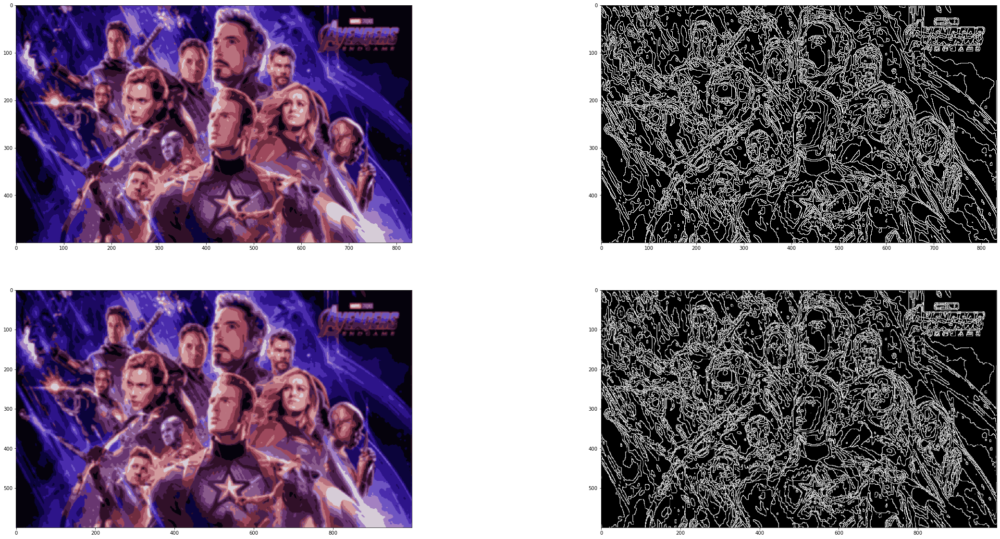

In [81]:
from skimage.transform import rescale

N = 16
scale_factor = 1.2

image_downscaled = rescale(image_smooth, (1/scale_factor, 1/scale_factor, 1.0))

palette2, image_recolorized2, labelsmap2, model2 = palette_kmeans(image_downscaled, N)
edgemap2 = labels_to_edges_thin(labelsmap2)   

image_recolorized2_upscaled = rescale(image_recolorized2, (scale_factor, scale_factor, 1.0))
edgemap2_upscaled =  rescale(edgemap2 * 255.0, (scale_factor, scale_factor))

plot_imagegrid([image_recolorized2, edgemap2, image_recolorized2_upscaled, edgemap2_upscaled], shape=(2,2), figsize=(40,20))

In [82]:
imageio.imwrite(f"../images/exploratory/avengers_xx_edges_thin_downscale_2.jpg", edgemap2_upscaled)
imageio.imwrite(f"../images/exploratory/avengers_xx_recolorized_downscale_2.jpg", image_recolorized2_upscaled)

Lossy conversion from float64 to uint8. Range [0.0, 255.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [2.721638178976221, 215.18000365443913]. Convert image to uint8 prior to saving to suppress this warning.


In [53]:
labelsmap_upscaled2 =  model2.predict(image_recolorized2_upscaled.reshape(-1,3))
edgemap3 = labels_to_edges_thin(labelsmap_upscaled2.reshape((image.shape[0], image.shape[1]))) 

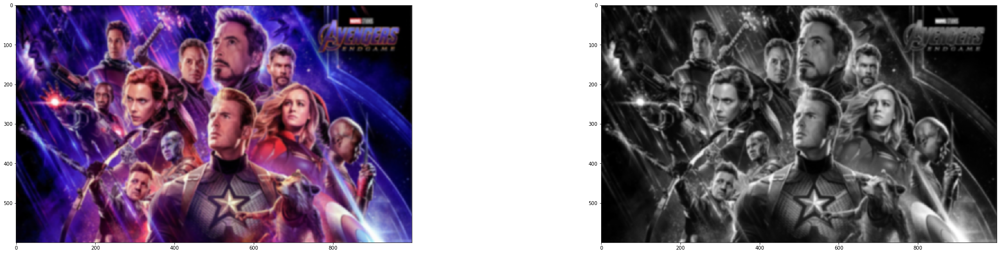

In [58]:
from skimage.color import rgb2gray

image_smooth_gray = rgb2gray(image_smooth)

plot_imagegrid([image_smooth, image_smooth_gray], shape=(2,2), figsize=(40,20))

# Explorando algoritmo de Segmentação Watershed e Sobel 

O código abaixo foi executado mais por curiosidade do grupo em visualizar algumas das técnicas vistas em aulas e já implementadas pelo skimage. Nenhum efeito prático no projeto em si portanto pode ser ignorado x)

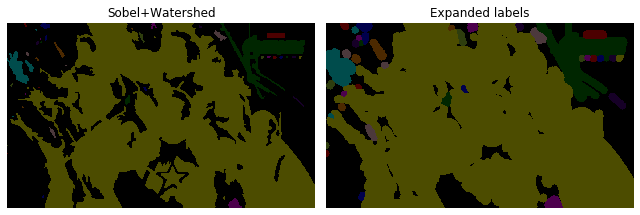

In [67]:
import numpy as np
import matplotlib.pyplot as plt

from skimage.filters import sobel
from skimage.measure import label
from skimage.segmentation import watershed, expand_labels
from skimage.color import label2rgb
from skimage import data

# coins = data.coins()
coins = image_smooth_gray.astype(np.int32)

# Make segmentation using edge-detection and watershed.
edges = sobel(coins)

# Identify some background and foreground pixels from the intensity values.
# These pixels are used as seeds for watershed.
markers = np.zeros_like(coins)
foreground, background = 1, 2
markers[coins < 15.0] = background
markers[coins > 60.0] = foreground

ws = watershed(edges, markers)
seg1 = label(ws == foreground)

expanded = expand_labels(seg1, distance=10)

# Show the segmentations.
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(9, 5),
                         sharex=True, sharey=True)

color1 = label2rgb(seg1, image=coins, bg_label=0)
axes[0].imshow(color1)
axes[0].set_title('Sobel+Watershed')

color2 = label2rgb(expanded, image=coins, bg_label=0)
axes[1].imshow(color2)
axes[1].set_title('Expanded labels')

for a in axes:
    a.axis('off')
fig.tight_layout()
plt.show()

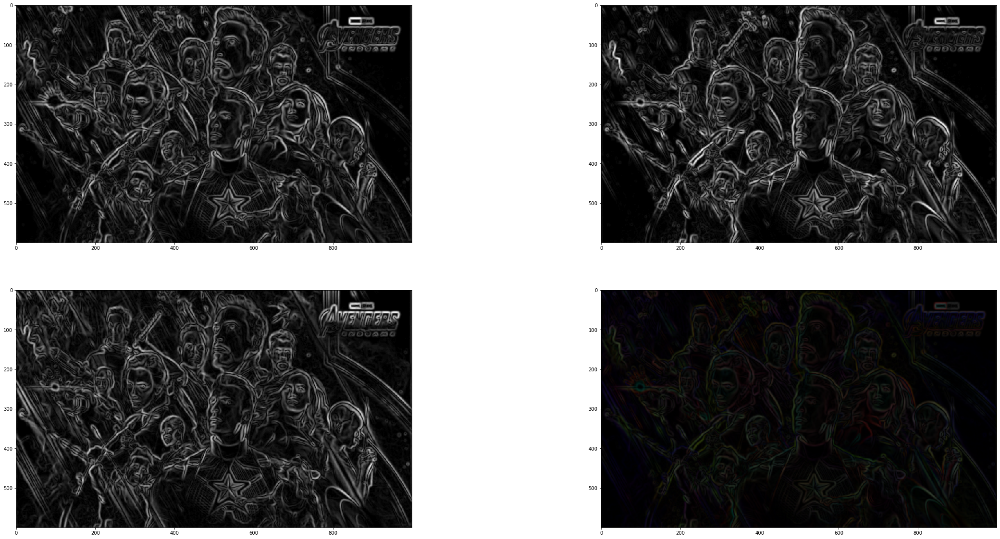

In [75]:
image_sobel = np.copy(image_smooth)

image_sobel[:,:,0] = sobel(image_smooth[:,:,0])
image_sobel[:,:,1] = sobel(image_smooth[:,:,1])
image_sobel[:,:,2] = sobel(image_smooth[:,:,2])


plot_imagegrid([image_sobel[:,:,0], image_sobel[:,:,1], image_sobel[:,:,2], image_sobel], shape=(2,2), figsize=(40,20))

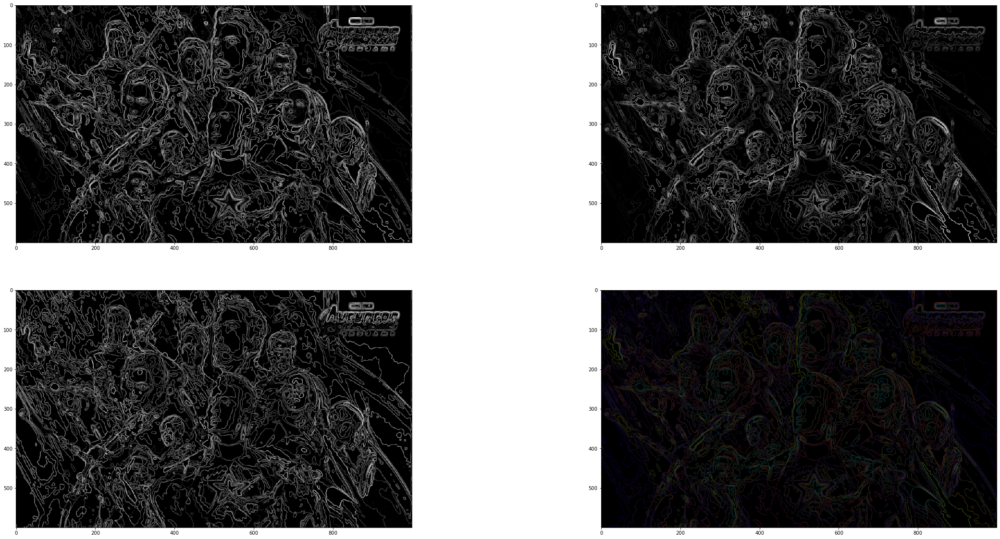

In [76]:
image_sobel = np.copy(image_recolorized)

image_sobel[:,:,0] = sobel(image_recolorized[:,:,0])
image_sobel[:,:,1] = sobel(image_recolorized[:,:,1])
image_sobel[:,:,2] = sobel(image_recolorized[:,:,2])


plot_imagegrid([image_sobel[:,:,0], image_sobel[:,:,1], image_sobel[:,:,2], image_sobel], shape=(2,2), figsize=(40,20))

## Extração de Paleta no espaço L * a * b

Em muitas das referências vistas utilizando o Kmeans, o espaço de cores utilizado era o L*a*b ao invés do RGB tradicional (acredito que seja por esse espaço distribuir as cores de forma mais uniforme ou algo do tipo que foi citado em aula).

Mas ao modificar o algoritmo de extraçaõ de paleta não chegamos a perceber nenhuma melhoria visualmente significativa que justificasse tal modificação.

1º Step - Loading image....
2º Step - Image pre-processing
3º Step - Palette extraction


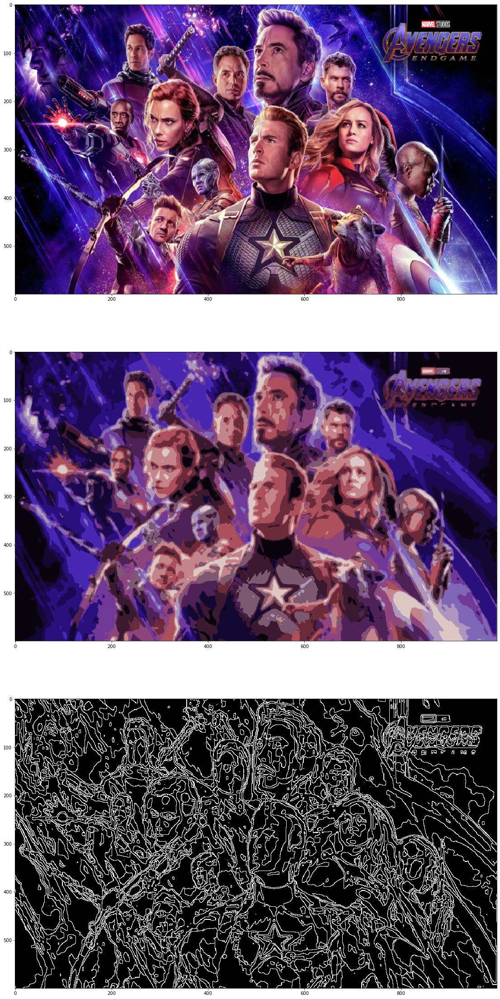

In [117]:
from skimage.color import rgb2lab, lab2rgb

image_path='/home/gabriel/Imagens/avengers.jpg'
N=16
palette_shape=(1,16)
save_name=None
# save_name="avengers3"

outpath = "../images/exploratory"

# 1º Step - Loading RGB image (ignore 4º channel if exists with image[:,:,:3])
print("1º Step - Loading image....")
image = load_image(image_path)[:,:,:3]

# 2º Step - Pré-processing
# ------------------------
# - Imagen Downsampling (max size to 1024)
# - Gaussian Filter (sigma=2 to smooth without lose much details)
print("2º Step - Image pre-processing")
image = image_downsampling(image)
image_smooth = np.zeros(image.shape)
for c in range(3):
    image_smooth[:,:,c] = gaussian_filter(image[:,:,c], sigma=2, mode='nearest')


# 3º Step - Palette Extraction (Kmeans) & Edge Detection
# ------------------------------------------------------
print("3º Step - Palette extraction")
palette, image_recolorized, labelsmap, model = palette_kmeans(rgb2lab(image_smooth/255.0), N)
# edgemap = labels_to_edges(labelsmap)
edgemap = labels_to_edges_thin(labelsmap) 


plot_imagegrid([image, lab2rgb(image_recolorized)*255.0, edgemap], shape=(3,1), figsize=(40,40))

1º Step - Loading image....
2º Step - Image pre-processing
3º Step - Palette extraction


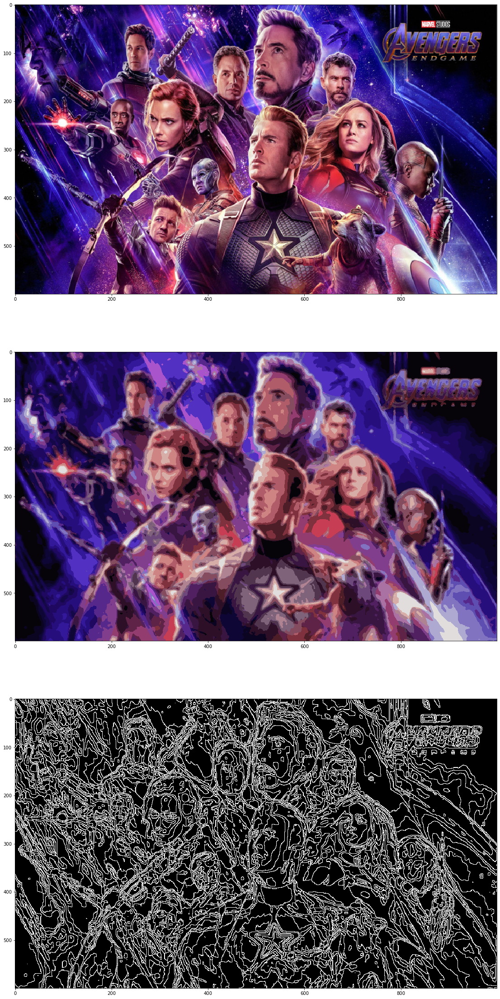

In [118]:
from skimage.color import rgb2lab, lab2rgb

image_path='/home/gabriel/Imagens/avengers.jpg'
N=32
palette_shape=(1,16)
save_name=None
# save_name="avengers3"

outpath = "../images/exploratory"

# 1º Step - Loading RGB image (ignore 4º channel if exists with image[:,:,:3])
print("1º Step - Loading image....")
image = load_image(image_path)[:,:,:3]

# 2º Step - Pré-processing
# ------------------------
# - Imagen Downsampling (max size to 1024)
# - Gaussian Filter (sigma=2 to smooth without lose much details)
print("2º Step - Image pre-processing")
image = image_downsampling(image)
image_smooth = np.zeros(image.shape)
for c in range(3):
    image_smooth[:,:,c] = gaussian_filter(image[:,:,c], sigma=2, mode='nearest')


# 3º Step - Palette Extraction (Kmeans) & Edge Detection
# ------------------------------------------------------
print("3º Step - Palette extraction")
palette, image_recolorized, labelsmap, model = palette_kmeans(rgb2lab(image_smooth/255.0), N)
# edgemap = labels_to_edges(labelsmap)
edgemap = labels_to_edges_thin(labelsmap) 


plot_imagegrid([image, lab2rgb(image_recolorized)*255.0, edgemap], shape=(3,1), figsize=(40,40))

1º Step - Loading image....
2º Step - Image pre-processing
3º Step - Palette extraction


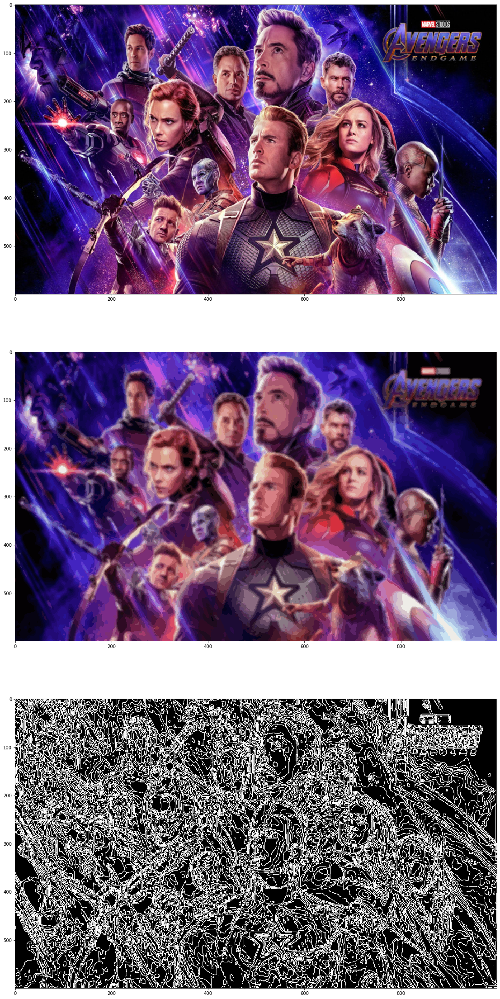

In [119]:
from skimage.color import rgb2lab, lab2rgb

image_path='/home/gabriel/Imagens/avengers.jpg'
N=128
palette_shape=(1,16)
save_name=None
# save_name="avengers3"

outpath = "../images/exploratory"

# 1º Step - Loading RGB image (ignore 4º channel if exists with image[:,:,:3])
print("1º Step - Loading image....")
image = load_image(image_path)[:,:,:3]

# 2º Step - Pré-processing
# ------------------------
# - Imagen Downsampling (max size to 1024)
# - Gaussian Filter (sigma=2 to smooth without lose much details)
print("2º Step - Image pre-processing")
image = image_downsampling(image)
image_smooth = np.zeros(image.shape)
for c in range(3):
    image_smooth[:,:,c] = gaussian_filter(image[:,:,c], sigma=2, mode='nearest')


# 3º Step - Palette Extraction (Kmeans) & Edge Detection
# ------------------------------------------------------
print("3º Step - Palette extraction")
palette, image_recolorized, labelsmap, model = palette_kmeans(rgb2lab(image_smooth/255.0), N)
# edgemap = labels_to_edges(labelsmap)
edgemap = labels_to_edges_thin(labelsmap) 


plot_imagegrid([image, lab2rgb(image_recolorized)*255.0, edgemap], shape=(3,1), figsize=(40,40))